# Vision system for playing memory

This notebook has been structurated in three parts. In the first, the functions of the systems are implemented one by one for understanding the behaviour of the system, so is more for testing and set the values for the right functioning of the system. Then, in a second part the real game is implemented. In the last part, some images are shown for evaluating the system. 


# First part 


Import of the functions necessary for the systems. Some of them are taken from previous laboratories while others have been created for the vision system. 

In [2]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

from functions import find_cards_in_image_blob, load_sift_references, analyze_board, \
                    find_pairs, draw_and_show_board, mapping_images_in_subfolder_with_number, \
                    load_and_detect_cards, find_cards_in_image_blob

%load_ext autoreload
%autoreload 2

Configuration of the system: costants, images paths, parmeters for the output images and parameters for the detection and recognizing functions are implemented

In [3]:
# Constants
EXPECTED_CARDS = 16

# Paths 
REF_FACEUP_CARD_DATASET_PATH = "face_up_cards/" 
GAME_IMAGE_WITH_FACEUP_PATH = "test_images/IMG_2104.jpg" #used for testing     
IMAGE_PATH = GAME_IMAGE_WITH_FACEUP_PATH

# Rectangles parameters
RECT_COLOR_FACE_DOWN = (0, 0, 255)  
RECT_COLOR_FACE_UP_MATCH = (0, 255, 0)    
RECT_COLOR_FACE_UP_NOMATCH = (0, 255, 255) 
RECTANGLE_THICKNESS = 20
OUTPUT_WINDOW_NAME = "Detection of Cards"

# SIFT, RANSAC e Augmentation parameters
AUGMENTATION_FACTOR_M = 4   
REFERENCE_IMAGE_SIZE = (150, 150) 
MIN_RAW_MATCHES_FOR_RANSAC = 10 
RANSAC_ITERATIONS = 500          
RANSAC_THRESHOLD_PIXELS = 5.0          
MIN_INLIER_COUNT_FOR_ID = 10    


Implementation of the detection of images on the game table


Number of detected cards: 16


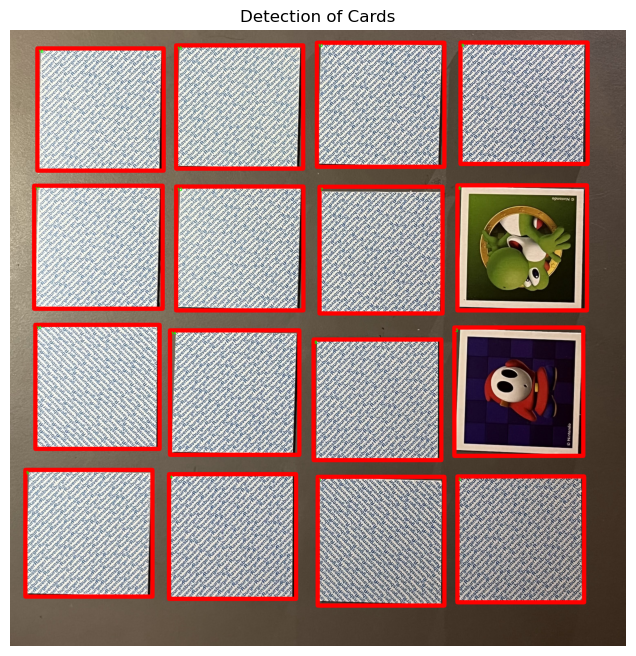

In [4]:
if not os.path.exists(IMAGE_PATH):
    print(f"ERROR: the image path '{IMAGE_PATH}' does not exist.")
else:
    original_image_copy, detected_card_boxes, _ = find_cards_in_image_blob(IMAGE_PATH, EXPECTED_CARDS)

    if original_image_copy is not None and detected_card_boxes:
        print(f"\nNumber of detected cards: {len(detected_card_boxes)}")
        image_with_rectangles = original_image_copy 
        
        if len(detected_card_boxes) != EXPECTED_CARDS:
            print(f"ATTENTION: Number of detected cards ({len(detected_card_boxes)}) different from the expected one ({EXPECTED_CARDS}).")

        for i, contour in enumerate(detected_card_boxes):
            x, y, w, h = cv2.boundingRect(contour)
            cv2.rectangle(image_with_rectangles, (x, y), (x + w, y + h), RECT_COLOR_FACE_DOWN, RECTANGLE_THICKNESS)
            cv2.putText(image_with_rectangles, str(i+1), (x + 5, y + 20), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

        image_rgb = cv2.cvtColor(image_with_rectangles, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(8, 8))
        plt.imshow(image_rgb)
        plt.title(OUTPUT_WINDOW_NAME)
        plt.axis('off')
        plt.show()

Loading of the SIFT parameters and the database of the face-up cards


In [5]:
# Load the reference images and create the SIFT database
sift_config = {
       'REFERENCE_IMAGE_SIZE': REFERENCE_IMAGE_SIZE,
       'MIN_RAW_MATCHES_BEFORE_RANSAC': MIN_RAW_MATCHES_FOR_RANSAC,
       'RANSAC_ITERATIONS': RANSAC_ITERATIONS,
       'RANSAC_THRESHOLD_PIXELS': RANSAC_THRESHOLD_PIXELS,
       'MIN_INLIER_COUNT_FOR_ID': MIN_INLIER_COUNT_FOR_ID
   }

faceup_sift_db = load_sift_references(
    REF_FACEUP_CARD_DATASET_PATH,
    REFERENCE_IMAGE_SIZE,
    AUGMENTATION_FACTOR_M
)

if not faceup_sift_db:
    print("Impossible load the SIFT database of face-up cards. Check the path and images.")
    raise RuntimeError("SIFT database loading error")
print(f"Database SIFT loaded with {len(faceup_sift_db)} images.")

SIFT detection (kp+des) from: face_up_cards/
  Augmenting 'block' (M=4)...
  Loaded 5 set of (kp, des) for 'block'.
  Augmenting 'bowser' (M=4)...
  Loaded 5 set of (kp, des) for 'bowser'.
  Augmenting 'donkey_kong' (M=4)...
  Loaded 5 set of (kp, des) for 'donkey_kong'.
  Augmenting 'ghost' (M=4)...
  Loaded 5 set of (kp, des) for 'ghost'.
  Augmenting 'mario' (M=4)...
  Loaded 5 set of (kp, des) for 'mario'.
  Augmenting 'shy_guy' (M=4)...
  Loaded 5 set of (kp, des) for 'shy_guy'.
  Augmenting 'tod' (M=4)...
  Loaded 5 set of (kp, des) for 'tod'.
  Augmenting 'yoshi' (M=4)...
  Loaded 5 set of (kp, des) for 'yoshi'.
Database SIFT loaded with 8 images.


Detection of the images, analyzation of the cards, finding of the pairs in the image and drawing of the boxes around the cards 

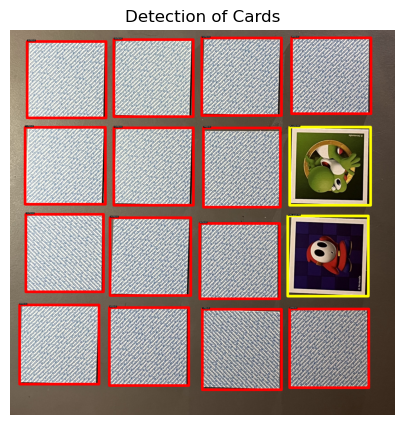

In [6]:
# Compare the detected cards with the reference images
# Detect the cards in the game image
current_image_path_for_blob = GAME_IMAGE_WITH_FACEUP_PATH 
image_for_drawing_display, detected_card_bboxes_coords, original_game_bgr = load_and_detect_cards(current_image_path_for_blob, EXPECTED_CARDS)
board_cards_status = analyze_board(detected_card_bboxes_coords, original_game_bgr, faceup_sift_db, sift_config)
image_display_final = image_for_drawing_display.copy() 
face_up_cards_on_board = [info for info in board_cards_status if info['state'] == "face-up" and info['id'] is not None]
found_pairs_info = find_pairs(face_up_cards_on_board)
draw_and_show_board(image_for_drawing_display, board_cards_status, found_pairs_info, RECT_COLOR_FACE_DOWN, RECT_COLOR_FACE_UP_MATCH, RECT_COLOR_FACE_UP_NOMATCH, RECTANGLE_THICKNESS, OUTPUT_WINDOW_NAME)

# Second step

Implementetion of the game simulation

Re definition of the characteristics of the system so that we isolate the previous part of testing with the actual game 


In [12]:
# Constants
EXPECTED_CARDS = 16

# Paths 
REF_FACEUP_CARD_DATASET_PATH = "face_up_cards/" 
STARTING_GAME_IMAGE = "IMG_2223.jpeg"  

# Rectangles parameters
RECT_COLOR_FACE_DOWN = (0, 0, 255)  
RECT_COLOR_FACE_UP_MATCH = (0, 255, 0)    
RECT_COLOR_FACE_UP_NOMATCH = (0, 255, 255) 
RECTANGLE_THICKNESS = 15
OUTPUT_WINDOW_NAME = "Detection of Cards"

# SIFT, RANSAC e Augmentation parameters
AUGMENTATION_FACTOR_M = 4   
REFERENCE_IMAGE_SIZE = (150, 150) 
MIN_RAW_MATCHES_FOR_RANSAC = 10 
RANSAC_ITERATIONS = 500          
RANSAC_THRESHOLD_PIXELS = 5.0          
MIN_INLIER_COUNT_FOR_ID = 10   

Creation of the SIFT database for the reference images

In [13]:
# Load the reference images and create the SIFT database
sift_config = {
       'REFERENCE_IMAGE_SIZE': REFERENCE_IMAGE_SIZE,
       'MIN_RAW_MATCHES_BEFORE_RANSAC': MIN_RAW_MATCHES_FOR_RANSAC,
       'RANSAC_ITERATIONS': RANSAC_ITERATIONS,
       'RANSAC_THRESHOLD_PIXELS': RANSAC_THRESHOLD_PIXELS,
       'MIN_INLIER_COUNT_FOR_ID': MIN_INLIER_COUNT_FOR_ID
   }

faceup_sift_db = load_sift_references(
    REF_FACEUP_CARD_DATASET_PATH,
    REFERENCE_IMAGE_SIZE,
    AUGMENTATION_FACTOR_M
)

if not faceup_sift_db:
    print("Impossible load the SIFT database of face-up cards. Check the path and images.")
    raise RuntimeError("SIFT database loading error")
print(f"Database SIFT loaded with {len(faceup_sift_db)} images.")

SIFT detection (kp+des) from: face_up_cards/
  Augmenting 'block' (M=4)...
  Loaded 5 set of (kp, des) for 'block'.
  Augmenting 'bowser' (M=4)...
  Loaded 5 set of (kp, des) for 'bowser'.
  Augmenting 'donkey_kong' (M=4)...
  Loaded 5 set of (kp, des) for 'donkey_kong'.
  Augmenting 'ghost' (M=4)...
  Loaded 5 set of (kp, des) for 'ghost'.
  Augmenting 'mario' (M=4)...
  Loaded 5 set of (kp, des) for 'mario'.
  Augmenting 'shy_guy' (M=4)...
  Loaded 5 set of (kp, des) for 'shy_guy'.
  Augmenting 'tod' (M=4)...
  Loaded 5 set of (kp, des) for 'tod'.
  Augmenting 'yoshi' (M=4)...
  Loaded 5 set of (kp, des) for 'yoshi'.
Database SIFT loaded with 8 images.


Implementation of the logic for simulating the game


Beginning of the game, this is the initial board with 16 expected cards.


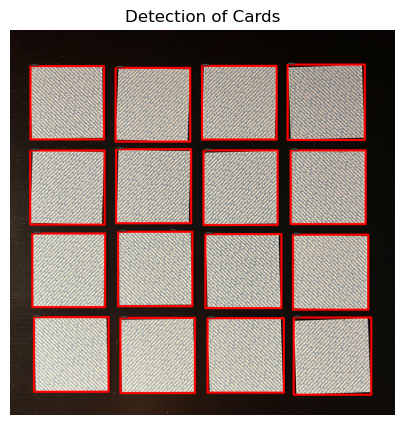

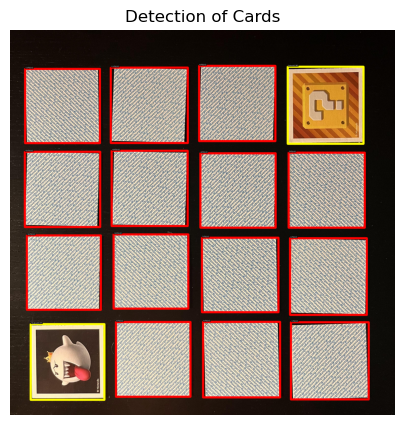

No match! Turn back the two cards face down again. Player 2 maythen continue.


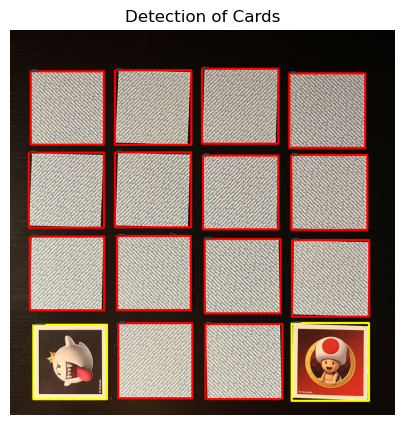

No match! Turn back the two cards face down again. Player 1 may then continue.


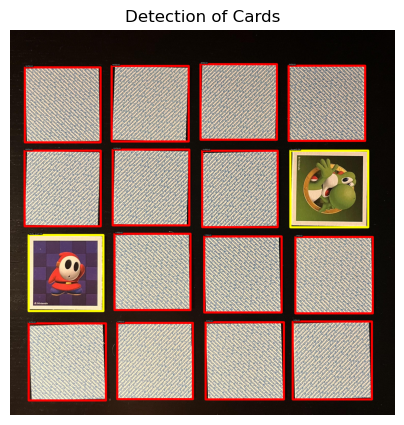

No match! Turn back the two cards face down again. Player 2 maythen continue.


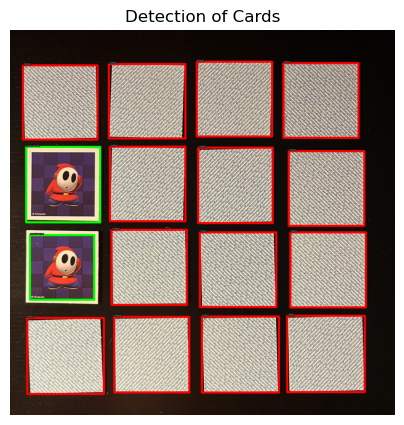

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 0 - Player 2: 1


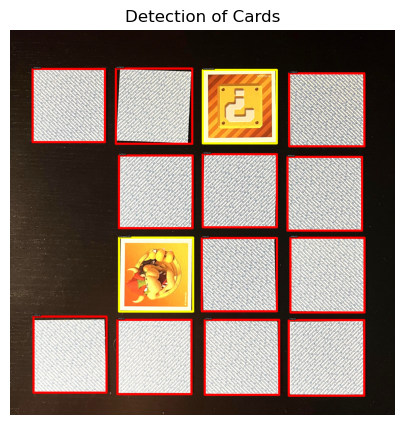

No match! Turn back the two cards face down again. Player 1 may then continue.


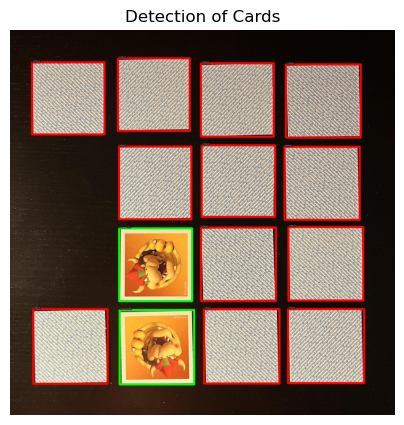

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 1 - Player 2: 1


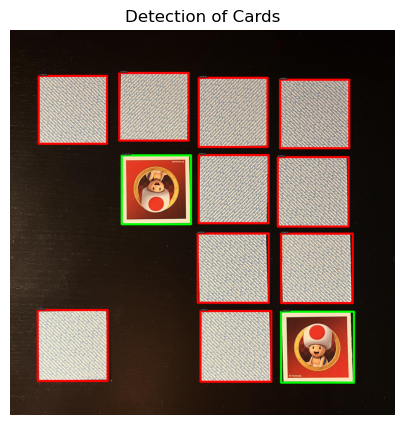

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 1


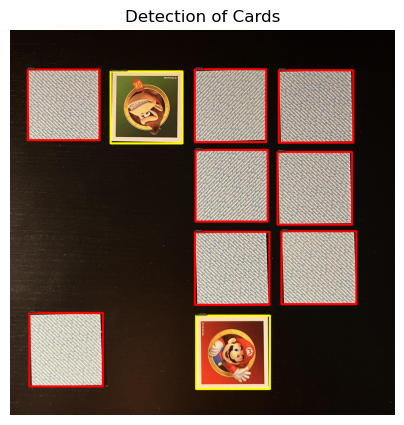

No match! Turn back the two cards face down again. Player 2 maythen continue.


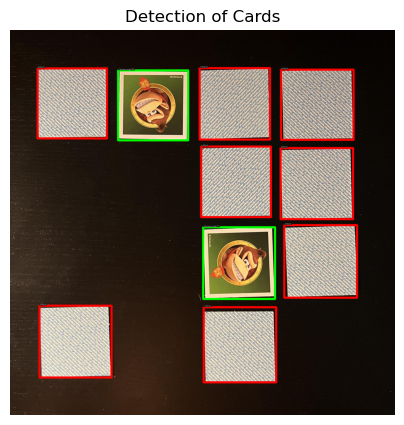

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 2


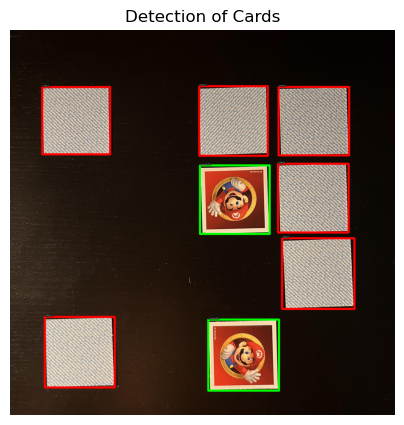

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 3


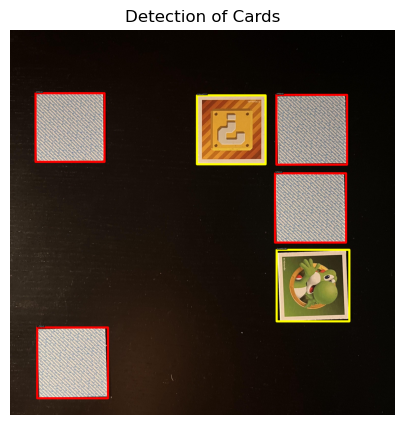

No match! Turn back the two cards face down again. Player 1 may then continue.


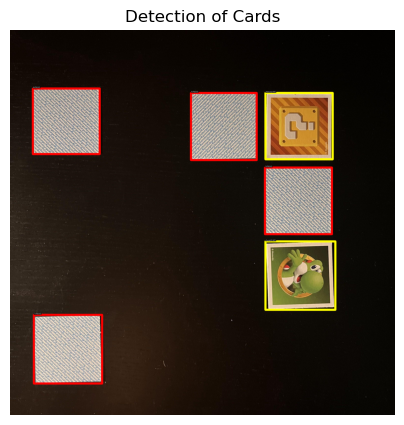

No match! Turn back the two cards face down again. Player 2 maythen continue.


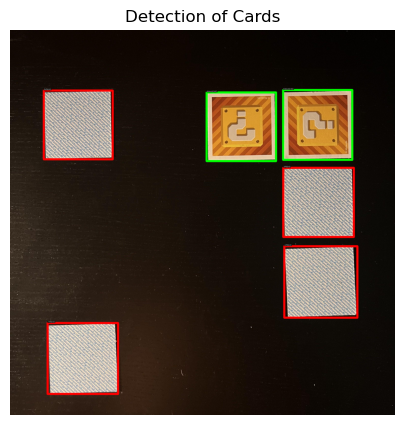

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 4


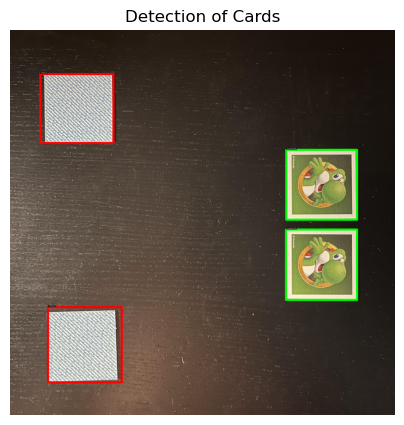

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 5


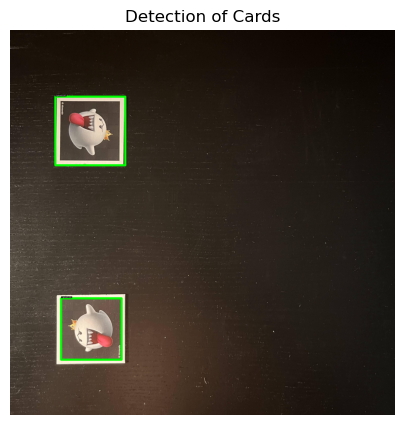

Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.
Player 1: 2 - Player 2: 6
Game over! Player 1: 2 - Player 2: 6
Player 2 wins!


In [14]:
score_player1 = 0
score_player2 = 0
found_cards = 0
up_to = 0

games = mapping_images_in_subfolder_with_number(
    "game_1/",
)

number_of_games = len(games)

print(f"Beginning of the game, this is the initial board with 16 expected cards.")
image_for_drawing_display, detected_card_bboxes_coords, original_game_bgr = load_and_detect_cards(STARTING_GAME_IMAGE, EXPECTED_CARDS)
board_cards_status = analyze_board(detected_card_bboxes_coords, original_game_bgr, faceup_sift_db, sift_config)
image_display_final = image_for_drawing_display.copy() 
face_up_cards_on_board = [info for info in board_cards_status if info['state'] == "face-up" and info['id'] is not None]
found_pairs_info = find_pairs(face_up_cards_on_board)
draw_and_show_board(image_for_drawing_display, board_cards_status, found_pairs_info, RECT_COLOR_FACE_DOWN, RECT_COLOR_FACE_UP_MATCH, RECT_COLOR_FACE_UP_NOMATCH, RECTANGLE_THICKNESS, OUTPUT_WINDOW_NAME)


for i in range(number_of_games):
    if up_to == 0:
        game = "game_1/" + games[i][1]
        image_for_drawing_display, detected_card_bboxes_coords, original_game_bgr = load_and_detect_cards(game, EXPECTED_CARDS)
        board_cards_status = analyze_board(detected_card_bboxes_coords, original_game_bgr, faceup_sift_db, sift_config)
        image_display_final = image_for_drawing_display.copy()
        face_up_cards_on_board = [info for info in board_cards_status if info['state'] == "face-up" and info['id'] is not None]
        found_pairs_info = find_pairs(face_up_cards_on_board)
        draw_and_show_board(image_for_drawing_display, board_cards_status, found_pairs_info, RECT_COLOR_FACE_DOWN, RECT_COLOR_FACE_UP_MATCH, RECT_COLOR_FACE_UP_NOMATCH, RECTANGLE_THICKNESS, OUTPUT_WINDOW_NAME)
        if len(found_pairs_info) > 0 and found_pairs_info[0][0]['id'] == found_pairs_info[0][1]['id']:
            score_player1 += 1
            found_cards += 1
            print(f"Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.")
            print(f"Player 1: {score_player1} - Player 2: {score_player2}")
        else:
            print(f"No match! Turn back the two cards face down again. Player 2 maythen continue.")
            up_to = 1  
    else:
        game = "game_1/" + games[i][1]
        image_for_drawing_display, detected_card_bboxes_coords, original_game_bgr = load_and_detect_cards(game, EXPECTED_CARDS)
        board_cards_status = analyze_board(detected_card_bboxes_coords, original_game_bgr, faceup_sift_db, sift_config)
        image_display_final = image_for_drawing_display.copy()
        face_up_cards_on_board = [info for info in board_cards_status if info['state'] == "face-up" and info['id'] is not None]
        found_pairs_info = find_pairs(face_up_cards_on_board)
        draw_and_show_board(image_for_drawing_display, board_cards_status, found_pairs_info, RECT_COLOR_FACE_DOWN, RECT_COLOR_FACE_UP_MATCH, RECT_COLOR_FACE_UP_NOMATCH, RECTANGLE_THICKNESS, OUTPUT_WINDOW_NAME)
        if len(found_pairs_info) > 0 and found_pairs_info[0][0]['id'] == found_pairs_info[0][1]['id']:
            score_player2 += 1
            found_cards += 1
            print(f"Congratulations! A matching pair. Please pick up your matching card pair and then you may continue.")
            print(f"Player 1: {score_player1} - Player 2: {score_player2}")
        else:
            print(f"No match! Turn back the two cards face down again. Player 1 may then continue.")
            up_to = 0 

if found_cards == 8:
    print(f"Game over! Player 1: {score_player1} - Player 2: {score_player2}")
    if score_player1 > score_player2:
        print("Player 1 wins!") 
    elif score_player2 > score_player1:
        print("Player 2 wins!")
    else:
        print("It's a tie!")

# Third part

Visualization of the testing images for evaluating the performance of the system


--- Start analysis in: test_images/ ---

Analyzing 1/40: IMG_2090.jpg...

Analyzing 2/40: IMG_2091.jpg...

Analyzing 3/40: IMG_2092.jpg...

Analyzing 4/40: IMG_2093.jpg...

Analyzing 5/40: IMG_2094.jpg...

Analyzing 6/40: IMG_2095.jpg...

Analyzing 7/40: IMG_2096.jpg...

Analyzing 8/40: IMG_2097.jpg...

Analyzing 9/40: IMG_2098.jpg...

Analyzing 10/40: IMG_2099.jpg...

Analyzing 11/40: IMG_2100.jpg...

Analyzing 12/40: IMG_2101.jpg...

Analyzing 13/40: IMG_2102.jpg...

Analyzing 14/40: IMG_2103.jpg...

Analyzing 15/40: IMG_2104.jpg...

Analyzing 16/40: IMG_2105.jpg...

Analyzing 17/40: IMG_2106.jpg...

Analyzing 18/40: IMG_2201.jpeg...

Analyzing 19/40: IMG_2203.jpeg...

Analyzing 20/40: IMG_2204.jpeg...

Analyzing 21/40: IMG_2205.jpeg...

Analyzing 22/40: IMG_2206.jpeg...

Analyzing 23/40: IMG_2207.jpeg...

Analyzing 24/40: IMG_2208.jpeg...

Analyzing 25/40: IMG_2209.jpeg...

Analyzing 26/40: IMG_2210.jpeg...

Analyzing 27/40: IMG_2211.jpeg...

Analyzing 28/40: IMG_2212.jpeg...

Anal

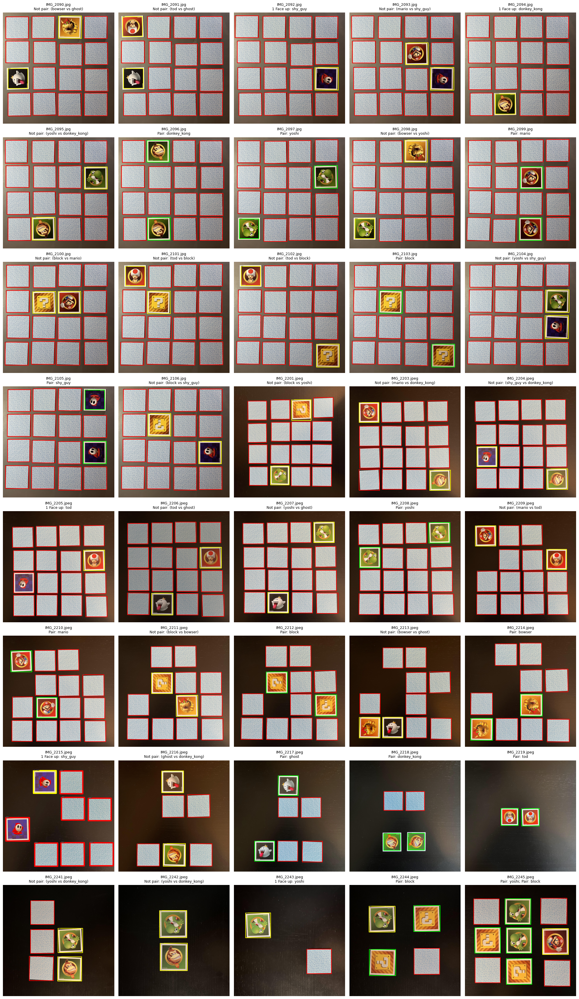


--- End analysis ---
Total number of images : 40
Total number of detected cards: 504
Total number of face-up cards: 79
Total number of face-down cards: 425


In [147]:
#------ Gemini's code for batch processing of images ------
from functions import analyze_board_for_verification
TEST_IMAGE_BATCH_FOLDER = "test_images/"  
IMAGES_PER_ROW_DISPLAY = 5                          
    

def display_image_grid(images_bgr_with_titles, images_per_row):
    if not images_bgr_with_titles:
        print("No images to display.")
        return

    num_images = len(images_bgr_with_titles)
    num_rows = (num_images + images_per_row - 1) // images_per_row
    
    plt.figure(figsize=(images_per_row * 4, num_rows * 4.5)) 
    
    for i, (img_bgr, title) in enumerate(images_bgr_with_titles):
        plt.subplot(num_rows, images_per_row, i + 1)
        if img_bgr is not None:
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
            plt.imshow(img_rgb)
        else: 
            plt.text(0.5, 0.5, 'Errore Img', horizontalalignment='center', verticalalignment='center')
        plt.title(title, fontsize=9) 
        plt.axis('off')
        
    plt.tight_layout(rect=[0, 0, 1, 0.96]) 
    plt.show()


print(f"\n--- Start analysis in: {TEST_IMAGE_BATCH_FOLDER} ---")
batch_results_to_display = [] 


total_cards_detected_in_batch = 0
total_cards_predicted_face_up_in_batch = 0
total_cards_predicted_face_down_in_batch = 0
total_images_processed_in_batch = 0
total_images_with_detection_errors = 0

if not os.path.exists(TEST_IMAGE_BATCH_FOLDER):
    print(f"ERROR: The folder '{TEST_IMAGE_BATCH_FOLDER}' doesn't exist.")
else:
    test_image_filenames = sorted([
        f for f in os.listdir(TEST_IMAGE_BATCH_FOLDER) 
        if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))
    ])

    if not test_image_filenames:
        print(f"No found image in '{TEST_IMAGE_BATCH_FOLDER}'.")
    else:
        total_images_to_process = len(test_image_filenames)
        for img_idx, img_filename in enumerate(test_image_filenames):
            full_img_path = os.path.join(TEST_IMAGE_BATCH_FOLDER, img_filename)
            print(f"\nAnalyzing {img_idx + 1}/{total_images_to_process}: {img_filename}...")
            total_images_processed_in_batch += 1 

            image_for_drawing, detected_contours, original_bgr = find_cards_in_image_blob(
                full_img_path, 
                EXPECTED_CARDS
            )

            if original_bgr is None or not detected_contours:
                print(f"  No card detected in {img_filename}.")
                error_img_placeholder = np.full((200, 200, 3), 128, dtype=np.uint8) 
                cv2.putText(error_img_placeholder, "No Cards Found", (10,100), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255),1)
                batch_results_to_display.append((error_img_placeholder, f"{img_filename}\n(No cards detected)"))
                total_images_with_detection_errors += 1 
                continue
            
            current_card_bboxes = [cv2.boundingRect(c) for c in detected_contours]
           
            if current_card_bboxes:
                num_detected = len(current_card_bboxes)
                               
                num_cols_approx = 4 
                num_rows_approx = np.ceil(num_detected / num_cols_approx) if num_cols_approx > 0 else 1
                avg_h_val = np.mean([b[3] for b in current_card_bboxes]) if num_detected > 0 else original_bgr.shape[0] / 4
                row_height_for_sorting = avg_h_val * 0.7 if num_detected > 0 else original_bgr.shape[0] / max(1, num_rows_approx)
                current_card_bboxes.sort(key=lambda bbox_item: ( 
                    round((bbox_item[1] + bbox_item[3]//2) / row_height_for_sorting), 
                    (bbox_item[0] + bbox_item[2]//2)                             
                ))

            predicted_board_status = analyze_board_for_verification(current_card_bboxes, original_bgr, faceup_sift_db, sift_config)
            
            total_cards_detected_in_batch += len(predicted_board_status) 
            for card_info_eval in predicted_board_status:
                if card_info_eval['state'] == "face-up":
                    total_cards_predicted_face_up_in_batch += 1
                elif card_info_eval['state'] == "face-down":
                    total_cards_predicted_face_down_in_batch += 1


            image_display_batch = image_for_drawing.copy() 
            
            
            face_up_identified_cards_this_image = [
                info for info in predicted_board_status 
                if info['state'] == "face-up" and info['id'] is not None
            ]

            cards_by_id = {}
            for card_info_iter in face_up_identified_cards_this_image: 
                card_id_iter = card_info_iter['id']
                if card_id_iter not in cards_by_id:
                    cards_by_id[card_id_iter] = []
                cards_by_id[card_id_iter].append(card_info_iter)

            all_found_pairs_indices_this_image = set() 
            summary_of_pairs_found_text = []

            for card_id_key, cards_list_for_id in cards_by_id.items():
    
                num_pairs_for_this_id = len(cards_list_for_id) // 2
                for i_pair in range(num_pairs_for_this_id):
                    card1_in_pair = cards_list_for_id[i_pair * 2]
                    card2_in_pair = cards_list_for_id[i_pair * 2 + 1]
                    all_found_pairs_indices_this_image.add(card1_in_pair['index'])
                    all_found_pairs_indices_this_image.add(card2_in_pair['index'])
                    summary_of_pairs_found_text.append(f"Pair: {card_id_key}")
            
          
            pair_id_string_display = "; ".join(summary_of_pairs_found_text) if summary_of_pairs_found_text else "Nessuna Coppia"
            if not summary_of_pairs_found_text and len(face_up_identified_cards_this_image) > 0:
             
                ids_scoperte_display = [c['id'] for c in face_up_identified_cards_this_image]
                if len(ids_scoperte_display) == 1 :
                    pair_id_string_display = f"1 Face up: {ids_scoperte_display[0]}"
                elif len(ids_scoperte_display) == 2: 
                     pair_id_string_display = f"Not pair: ({ids_scoperte_display[0]} vs {ids_scoperte_display[1]})"
                else: 
                     pair_id_string_display = f"Face down: {len(ids_scoperte_display)}"


            
            for card_info_draw in predicted_board_status: 
                x, y, w, h = card_info_draw['bbox']
                label_text = f"{card_info_draw['index']+1}" 
                rect_color = RECT_COLOR_FACE_DOWN
                
                if card_info_draw['state'] == "face-up":
                    card_id_display = card_info_draw['id'] if card_info_draw['id'] else 'Unk'
                    label_text += f":{card_id_display}(I:{card_info_draw['inliers']})"
                    if card_info_draw['index'] in all_found_pairs_indices_this_image: 
                        rect_color = RECT_COLOR_FACE_UP_MATCH
                    else:
                        rect_color = RECT_COLOR_FACE_UP_NOMATCH 
                else: 
                    label_text += f":FD(I:{card_info_draw['inliers']})"
                    
                cv2.rectangle(image_display_batch, (x, y), (x + w, y + h), rect_color, RECTANGLE_THICKNESS)
          
                label_size_txt, base_line_txt = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.3, 1)
                text_bg_y_start = y - label_size_txt[1] - base_line_txt - 1
                text_bg_y_end = y - base_line_txt + 1
                if text_bg_y_start < 0:
                    text_bg_y_end += abs(text_bg_y_start)
                    text_bg_y_start = 0
                cv2.rectangle(image_display_batch, 
                              (x, text_bg_y_start),
                              (x + label_size_txt[0] + 2, text_bg_y_end), 
                              (0,0,0), -1)
                cv2.putText(image_display_batch, label_text, 
                            (x + 1, y - base_line_txt -1 if y - base_line_txt -1 > label_size_txt[1] else y + label_size_txt[1]),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.3, (255,255,255), 1, cv2.LINE_AA)
            
            batch_results_to_display.append((image_display_batch, f"{img_filename}\n{pair_id_string_display}"))

        
        if batch_results_to_display:
            print("\nVisualization of the results...")
            display_image_grid(batch_results_to_display, IMAGES_PER_ROW_DISPLAY) 

print("\n--- End analysis ---")


print(f"Total number of images : {total_images_processed_in_batch}")
print(f"Total number of detected cards: {total_cards_detected_in_batch}")
print(f"Total number of face-up cards: {total_cards_predicted_face_up_in_batch}")
print(f"Total number of face-down cards: {total_cards_predicted_face_down_in_batch}")

